# Stability Analysis VCF Comparison

## OUTLINE

### 0- Reading CSV File (export 'Export Sheet' as .csv)
    ## https://docs.google.com/spreadsheets/d/1mDAMd1wk54RlQFEqKvuIQAwg_ajwCjZA7q2Lwkwx7Mo/edit?usp=sharing
### 1- Reading all generated VCF files from Google Drive
    ## https://drive.google.com/drive/folders/1zdC_THQvRqXscc-scfM78cm8sCOADIjx?usp=sharing
### 2- Reading High Confidence and Paper Validated VCF's
    ## --> Result: high_confidence / all_validated_set
### 3- Filtering each generated VCF
    ## Remove indels & FilterPass --> Result: sets_dict[key]
### 4- Combine VCF Files and their features
    ## Combining CSV file with generated VCF TestCase IDs. --> Result: vcfcomparison_df_full
### 5- Find best parameter with XGBoost based on intersection/union with HighConfidence.
    ## intersection(generated & validated) / total generated VCF Variant Length.
    ## Install (!conda install -c conda-forge py-xgboost-cpu -y) & Uncomment codes.
### 6- Finding the same TestCases with same parameters.  
    ## --> Result: inter_testcase_dict
### 7 - Heatmap between Generated VCFs with Recall.
### 8 - Heatmap between Generated VCFs with Recall (Mappers)
### 9 - Heatmap between Generated VCFs with Recall (Callers)
### 10 - Heatmap between Generated VCFs with Recall (Environment)
### 11 - Heatmap between Generated VCFs with Recall (Equal TestCases / Environments.)
### 12 - Scatter plot between Generated VCFs with Recall/Precision. 
### 13 - Violin plot between Generated VCFs with Recall. (Changeable: Parameter based.)
### 14 - Venn diagrams between Generated VCFs. (Environment)
### 15 - Venn diagrams between Generated VCFs and High Confidence. (Environment)

### Import Section

In [1]:
import os
import allel
import numpy as np # pip3 install matplotlib
import matplotlib.pyplot as plt # pip3 install matplotlib

import random
import community # can be installed with: "pip install python-louvain"
from numpy import linalg as LA
from tqdm import tqdm
import pandas as pd
from scipy import stats
from scipy.interpolate import interp1d
import time
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.colors
import math
import scipy.io as sio
from skimage import data, segmentation, color
from skimage.future import graph
from sklearn.preprocessing import MinMaxScaler
import plotly.express as px
from matplotlib_venn import venn2, venn2_circles, venn2_unweighted
from matplotlib_venn import venn3, venn3_circles
from matplotlib import pyplot as plt
from matplotlib.lines import Line2D  # for legend handle
from xgboost import XGBClassifier, XGBRegressor #!conda install -c conda-forge py-xgboost-cpu -y
from xgboost import plot_importance #!conda install py-xgboost-gpu
#from altair import *

<frozen importlib._bootstrap>:228: RuntimeWarning: scipy._lib.messagestream.MessageStream size changed, may indicate binary incompatibility. Expected 56 from C header, got 64 from PyObject


In [2]:
#!conda install -c conda-forge py-xgboost-cpu -y

### Common Funtions

In [3]:
#Deleting indels from VCF
def remove_indels(t):
    t = t[t["REF"].apply(len) == 1 ]
    t = t[t["ALT_1"].apply(len) == 1]
    return t 

#Apply Filters
def filtersControl(key,df,VCName):
    df = df.copy()
    
    #Getting variantCaller Name
    #VCName = key.split('/')
    
    #Apply Filter Pass if not somaticSniper
    #df = df if VCName == 'SomaticSniper' else df[df["FILTER_PASS"]=="SOMATIC"]
    
    #SOMATIC filter on strelka
    df = df[df['SOMATIC'].astype("bool")] if VCName == 'Strelka' else df
        
    return df

#Jaccard Similarity function for two sets ( int / )
def js_set(s1, s2):
    intersection = len(list(set(s1).intersection(s2)))
    union = uni(s1,s2)
    if union == 0:
        return 0;
    return np.float64(round((float(intersection) / union) * 100) / 100);

#The intersection of two sets is the set of all the common elements of both the sets. 
def intersec(s1,s2):
    return len(s1.intersection(s2))

#The union of two sets is the set of all the elements of both the sets without duplicates.
def uni(s1,s2):
    return len(s1.union(s2))

#The difference between two sets is the set of all the elements in first set that are not present in the second set. 
def dif(s1,s2):
    return len(s1.difference(s2))

#Percentage of intersects:
def percentage_intersects(intersection,count):
    return np.float64(round((float(intersection) / count) * 100) / 100);

#intersection/union:
def inter_union(s1,s2):
    return np.float64(round((float(intersec(s1,s2) / uni(s1,s2))) * 100) / 100);

# Get True Positives
def get_true_pos(pred, real):
    return len(pred & real);

# Get False Positives
def get_false_pos(pred, real):
    return len(pred - real);

# Get False Negatives
def get_false_neg(pred, real):
    return len(real - pred);

# Get TruePositive/FalsePositive
def get_precision(pred, real):
    tp = get_true_pos(pred, real) 
    fp = get_false_pos(pred, real) 
    return (1.0 * tp) / (tp + fp);

# Get TruePositive/FalseNegative
def get_recall(pred, real):
    tp = get_true_pos(pred, real)
    fn = get_false_neg(pred, real)
    return (1.0 * tp) / (tp + fn);

## 0- Reading CSV File

In [4]:
#headerList=["TestCaseNo","phase","Sample","operatingSystem","Environment","isTrimmed","baseRecalibration","Mapper","M_Version","VariantCaller","VC_Version","ReferenceGenom","Duplicates","VariantFilter","FilterPass","SOMATICfilter","remove_indels","Sort","FileLink","Result VCF Count","Author"]
csv_file_df = pd.read_csv('vcf/TestCases.csv')
csv_file_df

,TestCaseNo,phase,Sample,operatingSystem,HOW,isTrimmed,baseRecalibration,Mapper,M_Version,Variant Caller,...,ReferenceGenom,Duplicates,Variant Filter,FilterPass,SOMATICfilter,remove_indels,Sort,File Link,Result VCF Count,Kim yaptı :)
0,TestCase 1,notReady,LL,Linux,Local,YES,YES,BWA,NaN,Mutect,...,hg19,MARK,NaN,NaN,NaN,NaN,NaN,NaN,NaN,GAMZE
1,TestCase 2,notReady,LL,Linux,Local + COSAP,YES,YES,BWA,NaN,Mutect,...,hg19,MARK,NaN,NaN,NaN,NaN,NaN,NaN,NaN,ESRA
2,TestCase 3,notReady,LL,NaN,Uhem + COSAP,YES,YES,BWA,NaN,Mutect,...,hg19,MARK,NaN,NaN,NaN,NaN,NaN,NaN,NaN,GÜL EDA
3,TestCase 4,notReady,LL,MAC,Local,YES,YES,BWA,NaN,Mutect,...,hg19,MARK,NaN,NaN,NaN,NaN,NaN,NaN,NaN,GAMZE
4,TestCase 5,notReady,LL,MAC,Local + COSAP,YES,YES,BWA,NaN,Mutect,...,hg19,MARK,NaN,NaN,NaN,NaN,NaN,NaN,NaN,ESRA
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
571,TestCase 572,notReady,LL,Linux,Local + COSAP,NO,YES,BOWTIE,NaN,SomaticSniper,...,hg38,DELETE,NaN,NaN,NaN,NaN,NaN,NaN,NaN,ESRA
572,TestCase 573,notReady,LL,NaN,Uhem + COSAP,NO,YES,BOWTIE,NaN,SomaticSniper,...,hg38,DELETE,NaN,NaN,NaN,NaN,NaN,NaN,NaN,GÜL EDA
573,TestCase 574,notReady,LL,MAC,Local,NO,YES,BOWTIE,NaN,SomaticSniper,...,hg38,DELETE,NaN,NaN,NaN,NaN,NaN,NaN,NaN,GAMZE
574,TestCase 575,notReady,LL,MAC,Local + COSAP,NO,YES,BOWTIE,NaN,SomaticSniper,...,hg38,DELETE,NaN,NaN,NaN,NaN,NaN,NaN,NaN,ESRA


## 1- Reading all VCF files from Google Drive

In [5]:
vcf_filenames = {}
for root, directories, filenames in os.walk('vcf/TESTCASES'):
    for fn in filenames:
        if fn == '.DS_Store':
            continue;
        else:
            vcf_filenames[root[23:]] = os.path.join(root,fn)
            
print("Total file count:", len(vcf_filenames))

Total file count: 71


In [6]:
#vcf_filenames

In [7]:
vcfcomparison_df = pd.DataFrame(columns=["TestCase", "data", "mapper", "variantCaller", "VCFLength"])
vcfcomparison_df_full = pd.DataFrame(columns=["TestCaseNo","phase","Sample","operatingSystem","Environment","isTrimmed","baseRecalibration","Mapper","M_Version","VariantCaller","VC_Version","ReferenceGenom","Duplicates","VariantFilter","FilterPass","SOMATICfilter","remove_indels","Sort","FileLink","Result VCF Count","Author"])

for index, row in csv_file_df.iterrows():
    for key in vcf_filenames:
        if int(key)-1 == index:
            vcfcomparison_df.loc[len(vcfcomparison_df.index)] = [key , row[2],row[7],row[9],"0"] 
            vcfcomparison_df_full.loc[len(vcfcomparison_df_full.index)] = [row[0],row[1],row[2],row[3],row[4],row[5],row[6],row[7],row[8],row[9],row[10],row[11],row[12],row[13],row[14],row[15],row[16],row[17],row[18],"0",row[20]]

## 2- Reading High Confidence and Paper Validated VCF's


In [8]:
ll_filenames = {}
for root, directories, filenames in os.walk('vcf/validated_vcfs/LL1'):
    for fn in filenames:
        if fn == '.DS_Store':
            continue;
        else:
            ll_filenames[root[23:]] = os.path.join(root,fn)

In [9]:
#ll_filenames

In [10]:
ll_sets_dict = {}

ll_filtering_df = pd.DataFrame(columns=["Key", "Total Length", "After FilterPass", "After RemoveIndels"])

for key in tqdm(ll_filenames):
    #Creating a dataframe for each vcf.
    temp = allel.vcf_to_dataframe(ll_filenames[key],fields='variants/*')
    
    #Filtering - STARTS
    total_length = len(temp)
    #temp = filtersControl(key,temp) #FilterPass control for somaticSniper
    after_filterpass = len(temp)
    temp = remove_indels(temp)
    after_remove_indels = len(temp)
    #Filtering - ENDS
    
    #For printing changes in the vcf lengths
    ll_filtering_df.loc[len(ll_filtering_df.index)] = [key , total_length, after_filterpass,after_remove_indels]

    #Creating a set for each dataframe
    if len(temp) != 0 :
        ll_sets_dict[key]= set(temp[["CHROM","POS","REF","ALT_1"]].apply(lambda row: "_".join(map(str, row)), axis=1))

100%|█████████████████████████████████████████████| 9/9 [00:04<00:00,  2.19it/s]


In [11]:
#for keys in ll_sets_dict:
#    print(keys)

In [12]:
#Creating ultimate singular validated variant set

all_validated_set = set.intersection(ll_sets_dict['novo/somaticSniper'], ll_sets_dict['novo/strelka'], ll_sets_dict['novo/mutect'],
                                     ll_sets_dict['bwa/somaticSniper'], ll_sets_dict['bwa/strelka'], ll_sets_dict['bwa/mutect'],
                                     ll_sets_dict['bowtie/somaticSniper'], ll_sets_dict['bowtie/strelka'], ll_sets_dict['bowtie/mutect'])
len(all_validated_set)



2388

In [13]:
temp = allel.vcf_to_dataframe('vcf/hc_bed_filtered.recode.vcf',fields='variants/*')
temp = remove_indels(temp)
high_confidence = set(temp[["CHROM","POS","REF","ALT_1"]].apply(lambda row: "_".join(map(str, row)), axis=1))

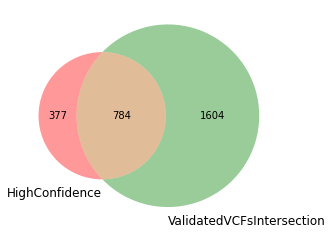

In [14]:
out = venn2([high_confidence, all_validated_set], ('HighConfidence','ValidatedVCFsIntersection'))

## 3- Filtering each generated VCF

In [15]:
sets_dict = {}
filtering_df = pd.DataFrame(columns=["Key", "Total Length", "After FilterPass", "After RemoveIndels"])

for key in tqdm(vcf_filenames):
    
    #Creating a dataframe for each vcf.
    temp = allel.vcf_to_dataframe(vcf_filenames[key],fields='variants/*')
    
    #Filtering - STARTS
    total_len = len(temp)
    for index,row in vcfcomparison_df.iterrows():
        if row[0] == key:
            VCName = row[3]
    
    temp = filtersControl(key,temp,VCName) #FilterPass control for somaticSniper
    after_Filterpass_len = len(temp)
    temp = remove_indels(temp) 
    without_indels_len = len(temp)
    #temp = temp[temp["CHROM"].apply(lambda x: "_" in x)]
    #Filtering - ENDS
    
    #For printing changes in the vcf lengths
    filtering_df.loc[len(filtering_df.index)] = [key , total_len, after_Filterpass_len,without_indels_len]
    
    sets_dict[key]= set(temp[["CHROM","POS","REF","ALT_1"]].apply(lambda row: "_".join(map(str, row)), axis=1))

100%|███████████████████████████████████████████| 71/71 [00:33<00:00,  2.15it/s]


## 4- Combine VCF Files and their features

In [16]:
vcfcomparison_df = pd.DataFrame(columns=["TestCase", "data", "mapper", "variantCaller", "VCFLength"])
vcfcomparison_df_midi = pd.DataFrame(columns=["isTrimmed","baseRecalibration","Mapper","VariantCaller","ReferenceGenom","Duplicates"])
vcfcomparison_df_full = pd.DataFrame(columns=["TestCaseNo","phase","Sample","operatingSystem","Environment","isTrimmed","baseRecalibration","Mapper","M_Version","VariantCaller","VC_Version","ReferenceGenom","Duplicates","VariantFilter","FilterPass","SOMATICfilter","remove_indels","Sort","FileLink","Result VCF Count","Author"])

for index, row in csv_file_df.iterrows():
    for key in vcf_filenames:
        if int(key)-1 == index:
            vcfcomparison_df.loc[len(vcfcomparison_df.index)] = [key , row[2],row[7],row[9],len(sets_dict[key])] 
            vcfcomparison_df_midi.loc[len(vcfcomparison_df_midi.index)] = [row[5],row[6],row[7],row[9],row[11],row[12]]
            vcfcomparison_df_full.loc[len(vcfcomparison_df_full.index)] = [row[0],row[1],row[2],row[3],row[4],row[5],row[6],row[7],row[8],row[9],row[10],row[11],row[12],row[13],row[14],row[15],row[16],row[17],row[18],len(sets_dict[key]),row[20]]
            
            

In [17]:
vcfcomparison_df_full.head()

,TestCaseNo,phase,Sample,operatingSystem,Environment,isTrimmed,baseRecalibration,Mapper,M_Version,VariantCaller,...,ReferenceGenom,Duplicates,VariantFilter,FilterPass,SOMATICfilter,remove_indels,Sort,FileLink,Result VCF Count,Author
0,TestCase 145,done,LL,Linux,Local,YES,YES,BWA,NaN,Mutect,...,hg38,MARK,NaN,NaN,NaN,NaN,NaN,NaN,5004,GAMZE
1,TestCase 151,done,LL,Linux,Local,NO,NO,BWA,NaN,Mutect,...,hg38,MARK,NaN,NaN,NaN,NaN,NaN,NaN,5598,GAMZE
2,TestCase 157,done,LL,Linux,Local,YES,NO,BWA,NaN,Mutect,...,hg38,MARK,NaN,NaN,NaN,NaN,NaN,NaN,5598,GAMZE
3,TestCase 159,done,LL,NaN,Uhem + COSAP,YES,NO,BWA,NaN,Mutect,...,hg38,MARK,NaN,NaN,NaN,NaN,NaN,https://drive.google.com/drive/folders/1nG9mtU...,7372,GÜL EDA
4,TestCase 163,done,LL,Linux,Local,NO,YES,BWA,NaN,Mutect,...,hg38,MARK,NaN,NaN,NaN,NaN,NaN,NaN,5005,GAMZE


In [18]:
#VCF All Variant Counts
#sns.set(rc={"figure.figsize":(3, 4)}) #width=3, #height=4
#cp = sns.catplot(x='Mapper', y='Result VCF Count', data=vcfcomparison_df_full, hue='Author',height=5, aspect=2)

#cp.fig.suptitle('Mapper')

## 5- Find best parameter with XGBoost based on intersection/union with HighConfidence.

In [19]:
#sets_dict[key] --> Our findings
#ll_sets_dict[key] --> Validated finding
 
df_validated_count =  pd.DataFrame(columns=["TestCase", "mapper", "variantCaller","isTrimmed","baseRecalibration","Duplicates","ValidatedVariantCount","ValidatedPercentage","Environment"])

for key in sets_dict:
    for index, row in vcfcomparison_df_full.iterrows():
        if key == row['TestCaseNo'].split(' ')[1]:
            for key_v in ll_sets_dict:
                newKey = (row['Mapper'] + '/' + row['VariantCaller']).lower()
                if key_v.lower() == newKey:
                    df_validated_count.loc[len(df_validated_count.index)] = [row['TestCaseNo'].split(' ')[1], row['Mapper'], row['VariantCaller'],row['isTrimmed'],row['baseRecalibration'],row['Duplicates'],intersec(sets_dict[key],high_confidence),percentage_intersects(intersec(sets_dict[key],high_confidence),row['Result VCF Count']),row['Environment']]
                    
df_validated_count.head()                                                     
                    

,TestCase,mapper,variantCaller,isTrimmed,baseRecalibration,Duplicates,ValidatedVariantCount,ValidatedPercentage,Environment
0,265,BOWTIE,SomaticSniper,YES,YES,MARK,741,0.04,Local
1,433,BWA,Mutect,YES,YES,DELETE,941,0.19,Local
2,253,BWA,SomaticSniper,YES,NO,MARK,852,0.24,Local
3,469,BOWTIE,Mutect,YES,NO,DELETE,927,0.20,Local
4,451,BWA,Mutect,NO,YES,DELETE,941,0.12,Local


In [20]:
cluster_df = df_validated_count.copy()
cluster_df["name"] = cluster_df[["mapper", "variantCaller", "TestCase","Environment"]].apply(lambda row: " ".join([row["mapper"].capitalize(), row["variantCaller"].capitalize(), row["TestCase"].upper(),row["Environment"].upper() ]), axis=1)
#cluster_df = cluster_df.set_index(['TestCase','mapper','variantCaller','Author'])
#cluster_df = cluster_df.drop(columns=["mapper", "variantCaller", "TestCase",'Author','isTrimmed','baseRecalibration','Duplicates','ValidatedVariantCount'], axis=1)
cluster_df
cluster_df = cluster_df.set_index('name')
cluster_df["ValidatedPercentage"] = cluster_df["ValidatedPercentage"].astype(float)
cluster_df[["mapper", "variantCaller", "isTrimmed", "baseRecalibration", "Duplicates", "Environment"]] = cluster_df[["mapper", "variantCaller", "isTrimmed", "baseRecalibration", "Duplicates", "Environment"]].astype("category")

cluster_df.head()
#cluster_df.to_pickle("omer.pkl")

In [21]:
model = XGBRegressor(tree_method="gpu_hist", enable_categorical=True)

In [22]:
'''model.fit(
    X=cluster_df[["mapper", "variantCaller", "isTrimmed", "baseRecalibration", "Duplicates", "Author"]], 
    y=cluster_df["ValidatedPercentage"]
)'''


'model.fit(\n    X=cluster_df[["mapper", "variantCaller", "isTrimmed", "baseRecalibration", "Duplicates", "Author"]], \n    y=cluster_df["ValidatedPercentage"]\n)'

In [23]:
#plot_importance(model)

In [24]:
#sns.clustermap(cluster_df.reset_index(drop=True))
#plt.show()

## 6- Finding the same TestCases with same parameters.  

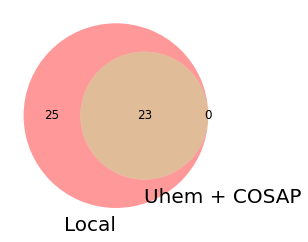

In [25]:
local = vcfcomparison_df_full.loc[vcfcomparison_df_full['Environment'] == "Local"]
uhemcosap = vcfcomparison_df_full.loc[vcfcomparison_df_full['Environment'] == "Uhem + COSAP"]
localcosap = vcfcomparison_df_full.loc[vcfcomparison_df_full['Environment'] == "Local + COSAP"]

set1 = set(local[["isTrimmed","baseRecalibration","Mapper","VariantCaller","ReferenceGenom","Duplicates"]].apply(lambda row: "_".join(map(str, row)), axis=1))
set2 = set(uhemcosap[["isTrimmed","baseRecalibration","Mapper","VariantCaller","ReferenceGenom","Duplicates"]].apply(lambda row: "_".join(map(str, row)), axis=1))
#set3 = set(localcosap[["isTrimmed","baseRecalibration","Mapper","VariantCaller","ReferenceGenom","Duplicates"]].apply(lambda row: "_".join(map(str, row)), axis=1))

out = venn2([set1, set2], ('Local','Uhem + COSAP'))
#venn3([set1, set2, set3], ('Local', 'Uhem + COSAP', 'Local + COSAP'))

#venn2(subsets = [set1, set2, set3], set_labels = ('Uhem + COSAP', 'Local + COSAP'))

#plt.rcParams['figure.figsize'] = [10, 5]

for text in out.set_labels:
    text.set_fontsize(20)

for text in out.subset_labels:
    text.set_fontsize(12) 

plt.rcdefaults()
# save the figure here

plt.show()

In [26]:
df_all =  pd.DataFrame(columns=["TestCase", "Feature"])

for index, row in tqdm(vcfcomparison_df_full.iterrows()):
   # df_all.loc[len(df_all.index)] = [row["TestCaseNo"].split(' ')[1],local[["isTrimmed","baseRecalibration","Mapper","VariantCaller","ReferenceGenom","Duplicates"]].apply(lambda row: "_".join(map(str, row)), axis=1)]
    a =   row["isTrimmed"] + "_" + row["baseRecalibration"] + "_" + row["Mapper"] + "_" + row["VariantCaller"] + "_" + row["ReferenceGenom"] + "_" + row["Duplicates"]
    df_all.loc[len(df_all.index)] = [row["TestCaseNo"].split(' ')[1], a]

    
inter_testcase_dict = {}

for index, row in tqdm(df_all.iterrows()):
    for index2, row2 in df_all.iterrows():
        if row['TestCase'] != row2['TestCase'] and row["Feature"] == row2["Feature"]:
            inter_testcase_dict[row['TestCase']] = row["Feature"]
             

71it [00:00, 634.69it/s]
71it [00:00, 293.90it/s]


In [27]:
# Same sets TestCase ids.
#inter_testcase_dict

## 7 - Heatmap between Generated VCFs with Recall.

In [28]:
df_generateds_r_p =  pd.DataFrame(columns=["TestCase1", "TestCase2", "Inter/Union"])

for key in tqdm(sets_dict):
    for key2 in sets_dict:
        for index, row in vcfcomparison_df_full.iterrows():
            if key == row['TestCaseNo'].split(' ')[1]:
                env_name = "local" if row['Author'] == 'GAMZE' else "uhem"
                newKey = (row['Mapper'] + '/' + row['VariantCaller']+ '/' + env_name + '/' + key).lower()
        for index, row in vcfcomparison_df_full.iterrows():
            if key2 == row['TestCaseNo'].split(' ')[1]:
                env_name2 = "local" if row['Author'] == 'GAMZE' else "uhem"
                newKey2 = (row['Mapper'] + '/' + row['VariantCaller']+ '/' + env_name2 + '/' + key2).lower() 
                
        df_generateds_r_p.loc[len(df_generateds_r_p.index)] = [newKey, newKey2, inter_union(sets_dict[key],sets_dict[key2])]


100%|███████████████████████████████████████████| 71/71 [01:14<00:00,  1.05s/it]


In [29]:
len(df_generateds_r_p.index)

5041

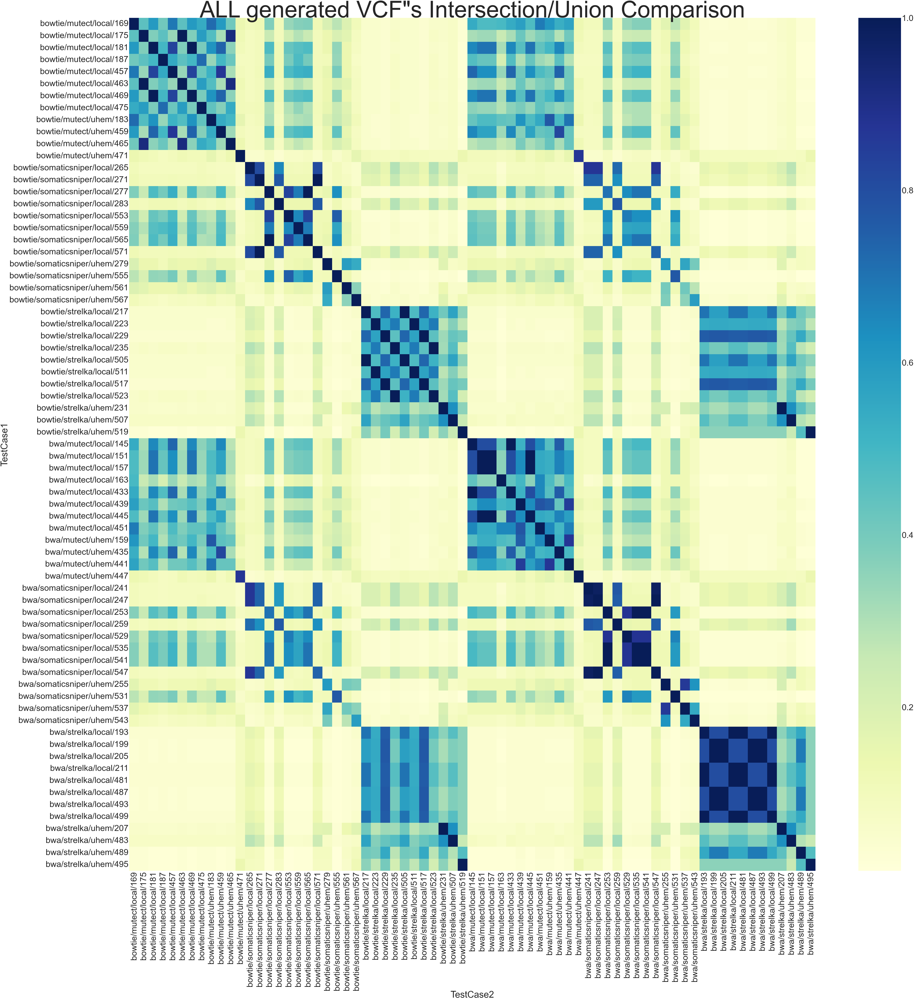

In [30]:
df_generateds_r = df_generateds_r_p.pivot_table(index='TestCase1', columns='TestCase2', values='Inter/Union')
plt.figure(figsize = (200,200), dpi=40)
sns.set(font_scale=10)
ax = sns.heatmap(df_generateds_r, annot=False, cmap="YlGnBu") #annot_kws={"size": 200}
ax.figure.axes[-1].set_ylabel('', size=200)
ax.set_title('ALL generated VCF"s Intersection/Union Comparison', fontdict={'fontsize': 300, 'fontweight': 'medium'})
fig = ax.get_figure()
#fig.savefig("out.png") 

## 8 - Heatmap between Generated VCFs with Recall (Mappers)

In [31]:
df_generateds_r_p_bwa = pd.DataFrame(columns=["TestCase1", "TestCase2", "Inter/Union"])
df_generateds_r_p_bowtie = pd.DataFrame(columns=["TestCase1", "TestCase2", "Inter/Union"])


for index, row in tqdm(df_generateds_r_p.iterrows()):
    if 'bwa' == row['TestCase1'].split('/')[0] and 'bwa' == row['TestCase2'].split('/')[0] :
        df_generateds_r_p_bwa.loc[len(df_generateds_r_p_bwa.index)] = row
    elif 'bowtie' == row['TestCase1'].split('/')[0] and 'bowtie' == row['TestCase2'].split('/')[0]:
        df_generateds_r_p_bowtie.loc[len(df_generateds_r_p_bowtie.index)] = row    


5041it [00:03, 1296.83it/s]


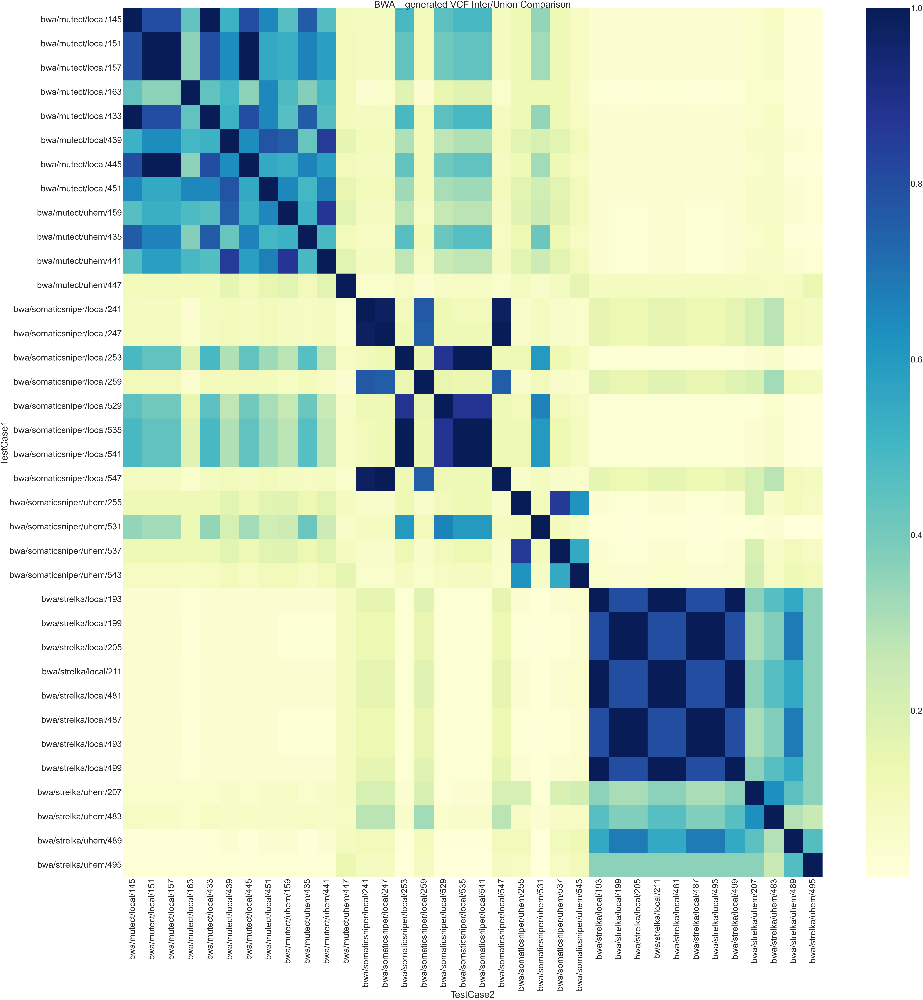

In [32]:
# BWA RECALL HEATMAP
df_generateds_r_bwa = df_generateds_r_p_bwa.pivot_table(index='TestCase1', columns='TestCase2', values='Inter/Union')
plt.figure(figsize = (200,200), dpi=40)
#sns.set(font_scale=7)
ax = sns.heatmap(df_generateds_r_bwa, annot=False, cmap="YlGnBu") #annot_kws={"size": 200}
ax.set_title('BWA _ generated VCF Inter/Union Comparison')

fig = ax.get_figure()


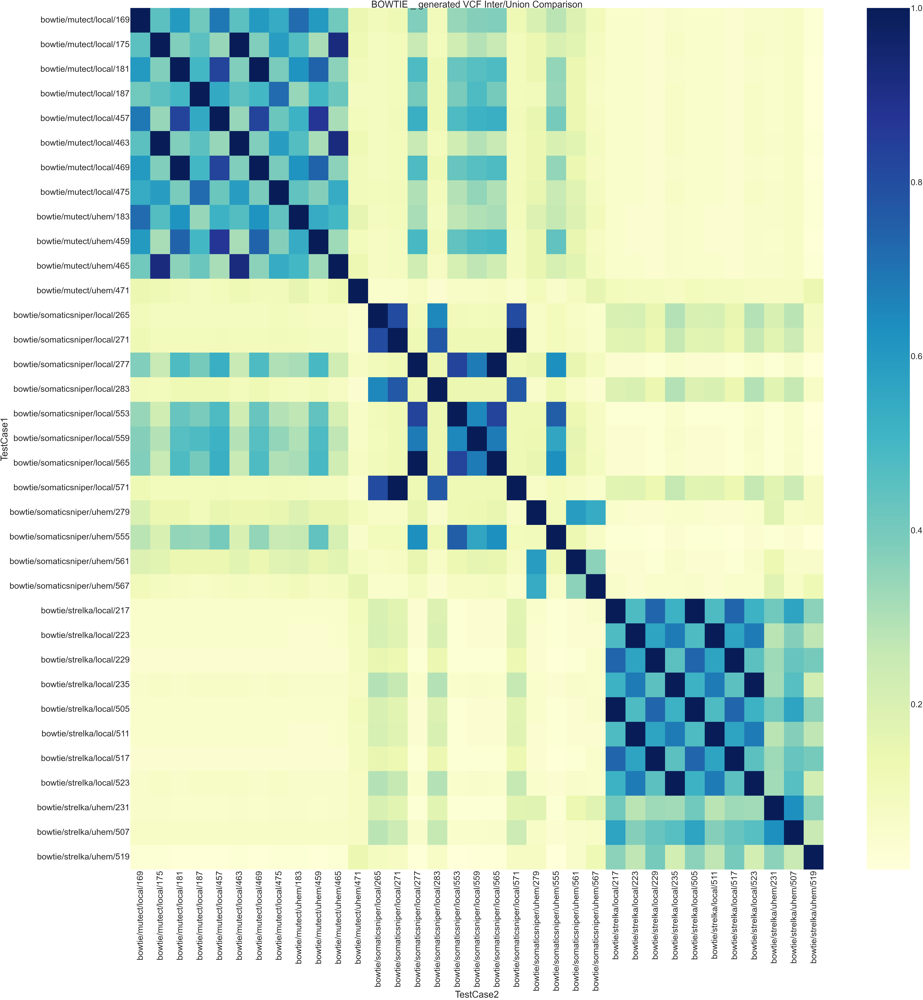

In [33]:
# BOWTIE RECALL HEATMAP
df_generateds_r_bowtie = df_generateds_r_p_bowtie.pivot_table(index='TestCase1', columns='TestCase2', values='Inter/Union')
plt.figure(figsize = (200,200), dpi=40)
ax = sns.heatmap(df_generateds_r_bowtie, annot=False, cmap="YlGnBu") #annot_kws={"size": 200}
ax.set_title('BOWTIE _ generated VCF Inter/Union Comparison')

fig = ax.get_figure()

## 9 - Heatmap between Generated VCFs with Recall (Callers)

In [34]:
df_generateds_r_p_m = pd.DataFrame(columns=["TestCase1", "TestCase2", "Inter/Union"]) #mutect
df_generateds_r_p_s = pd.DataFrame(columns=["TestCase1", "TestCase2", "Inter/Union"]) #strelka
df_generateds_r_p_ss = pd.DataFrame(columns=["TestCase1", "TestCase2", "Inter/Union"]) #somaticsniper

for index, row in tqdm(df_generateds_r_p.iterrows()):
    if 'mutect' == row['TestCase1'].split('/')[1] and 'mutect' == row['TestCase2'].split('/')[1]:
        df_generateds_r_p_m.loc[len(df_generateds_r_p_m.index)] = row
    elif 'strelka' == row['TestCase1'].split('/')[1] and 'strelka' == row['TestCase2'].split('/')[1]:
        df_generateds_r_p_s.loc[len(df_generateds_r_p_s.index)] = row    
    elif 'somaticsniper' == row['TestCase1'].split('/')[1] and 'somaticsniper' == row['TestCase2'].split('/')[1]:
        df_generateds_r_p_ss.loc[len(df_generateds_r_p_ss.index)] = row      

5041it [00:03, 1506.24it/s]


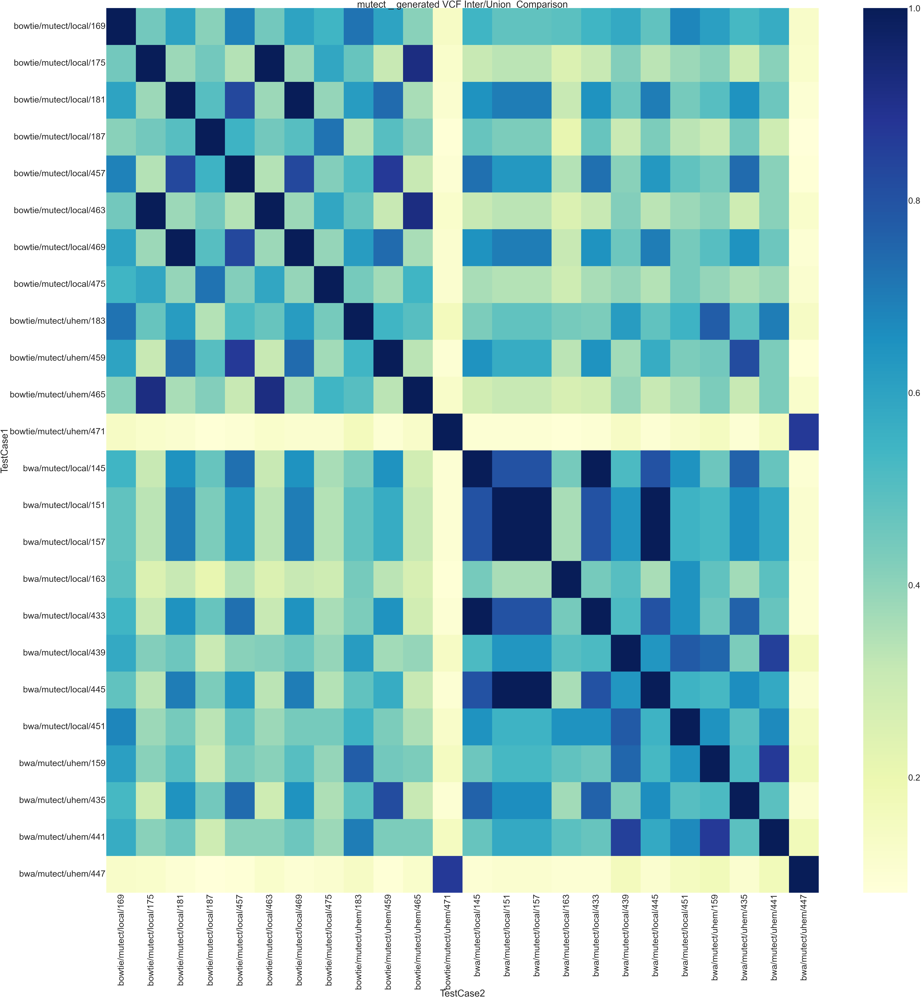

In [35]:
# mutect RECALL HEATMAP
df_generateds_r_m = df_generateds_r_p_m.pivot_table(index='TestCase1', columns='TestCase2', values='Inter/Union')
plt.figure(figsize = (200,200), dpi=40)
ax = sns.heatmap(df_generateds_r_m, annot=False, cmap="YlGnBu") #annot_kws={"size": 200}
ax.set_title('mutect _ generated VCF Inter/Union  Comparison')

fig = ax.get_figure()

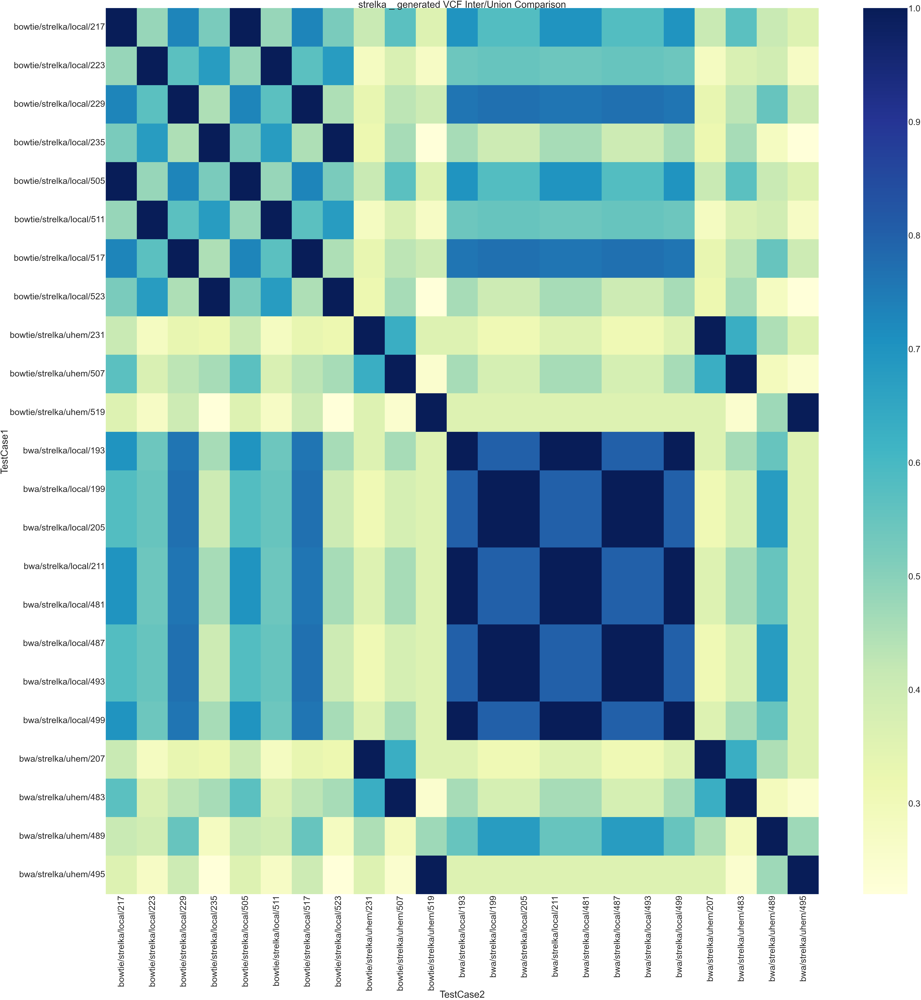

In [36]:
# strelka RECALL HEATMAP
df_generateds_r_s = df_generateds_r_p_s.pivot_table(index='TestCase1', columns='TestCase2', values='Inter/Union')
plt.figure(figsize = (200,200), dpi=40)
ax = sns.heatmap(df_generateds_r_s, annot=False, cmap="YlGnBu") #annot_kws={"size": 200}
ax.set_title('strelka _ generated VCF Inter/Union Comparison')

fig = ax.get_figure()

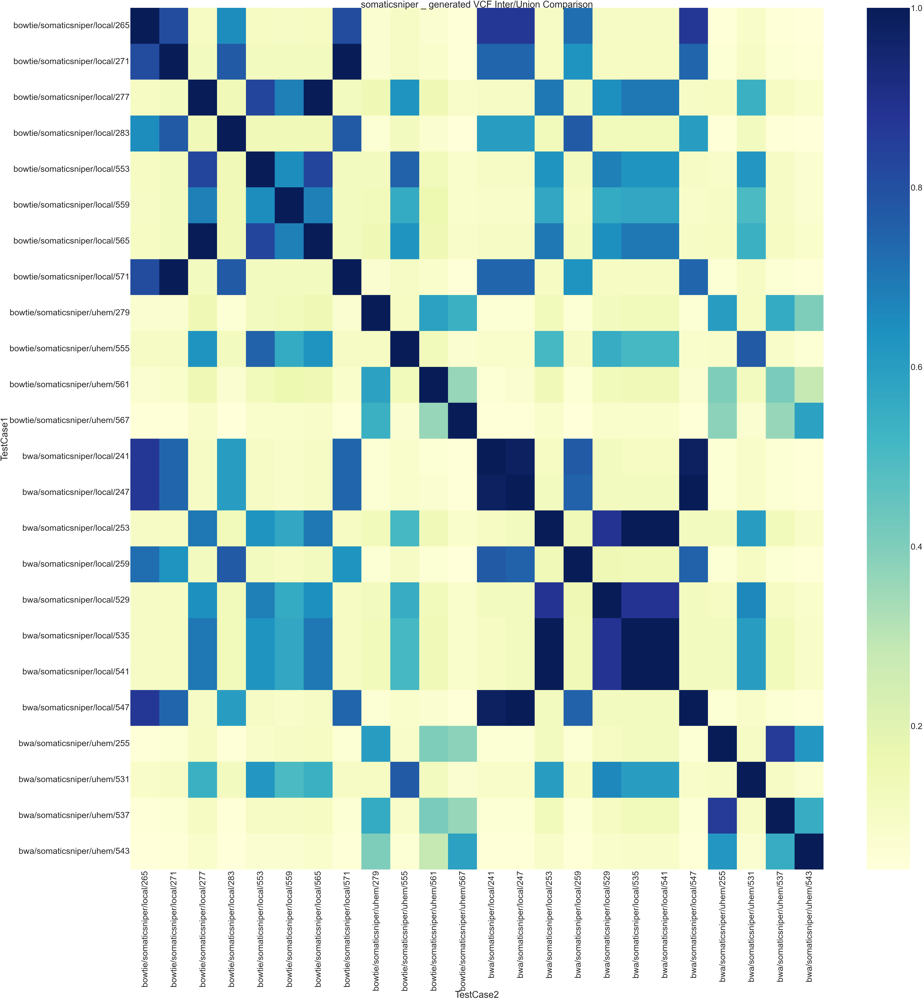

In [37]:
# somaticsniper RECALL HEATMAP
df_generateds_r_ss = df_generateds_r_p_ss.pivot_table(index='TestCase1', columns='TestCase2', values='Inter/Union')
plt.figure(figsize = (200,200), dpi=40)
ax = sns.heatmap(df_generateds_r_ss, annot=False, cmap="YlGnBu") #annot_kws={"size": 200}
ax.set_title('somaticsniper _ generated VCF Inter/Union Comparison')

fig = ax.get_figure()

## 10 - Heatmap between Generated VCFs with Recall (Environment)

In [41]:
df_generateds_r_p_local = pd.DataFrame(columns=["TestCase1", "TestCase2", "Inter/Union"]) #mutect
df_generateds_r_p_uhemCosap = pd.DataFrame(columns=["TestCase1", "TestCase2", "Inter/Union"]) #strelka

for index, row in tqdm(df_generateds_r_p.iterrows()):
    if 'local' == row['TestCase1'].split('/')[2] and 'local' == row['TestCase2'].split('/')[2]:
        df_generateds_r_p_local.loc[len(df_generateds_r_p_local.index)] = row
    elif 'uhem' == row['TestCase1'].split('/')[2] and 'uhem' == row['TestCase2'].split('/')[2]:
        df_generateds_r_p_uhemCosap.loc[len(df_generateds_r_p_uhemCosap.index)] = row     

5041it [00:04, 1167.99it/s]


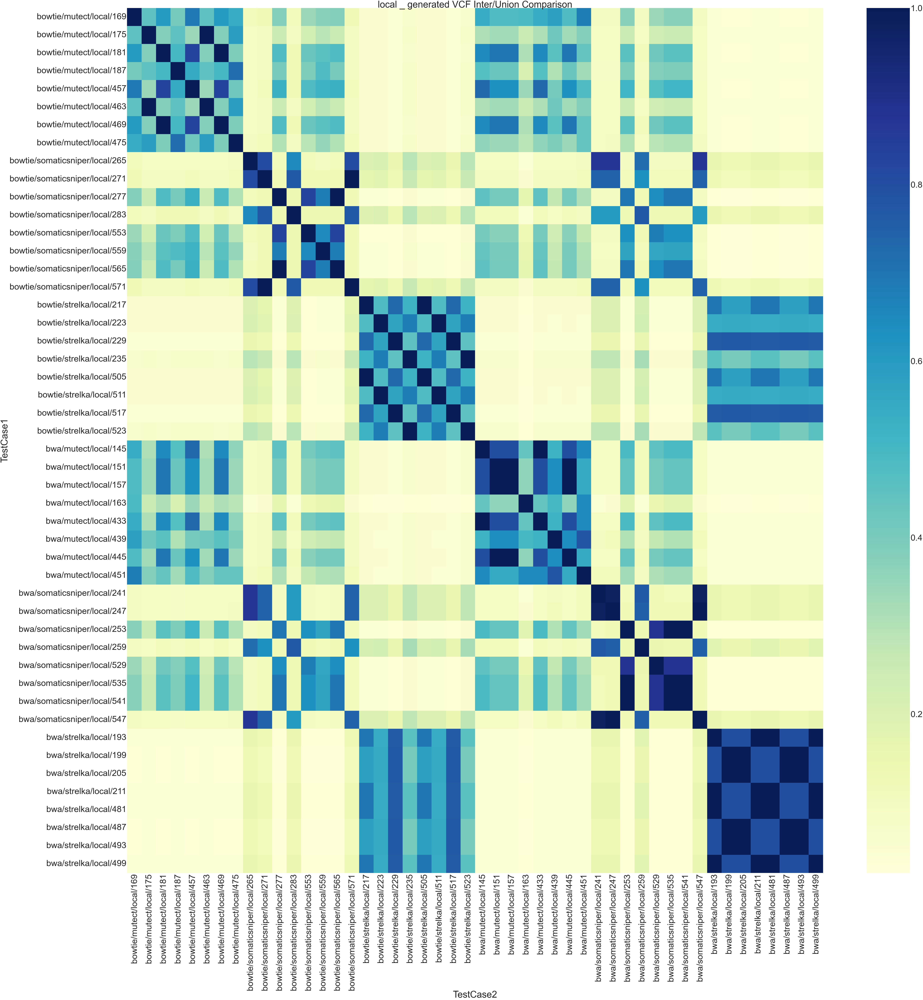

In [43]:
# local RECALL HEATMAP
df_generateds_r_local = df_generateds_r_p_local.pivot_table(index='TestCase1', columns='TestCase2', values='Inter/Union')
plt.figure(figsize = (200,200), dpi=40)
ax = sns.heatmap(df_generateds_r_local, annot=False, cmap="YlGnBu") #annot_kws={"size": 200}
ax.set_title('local _ generated VCF Inter/Union Comparison')

fig = ax.get_figure()

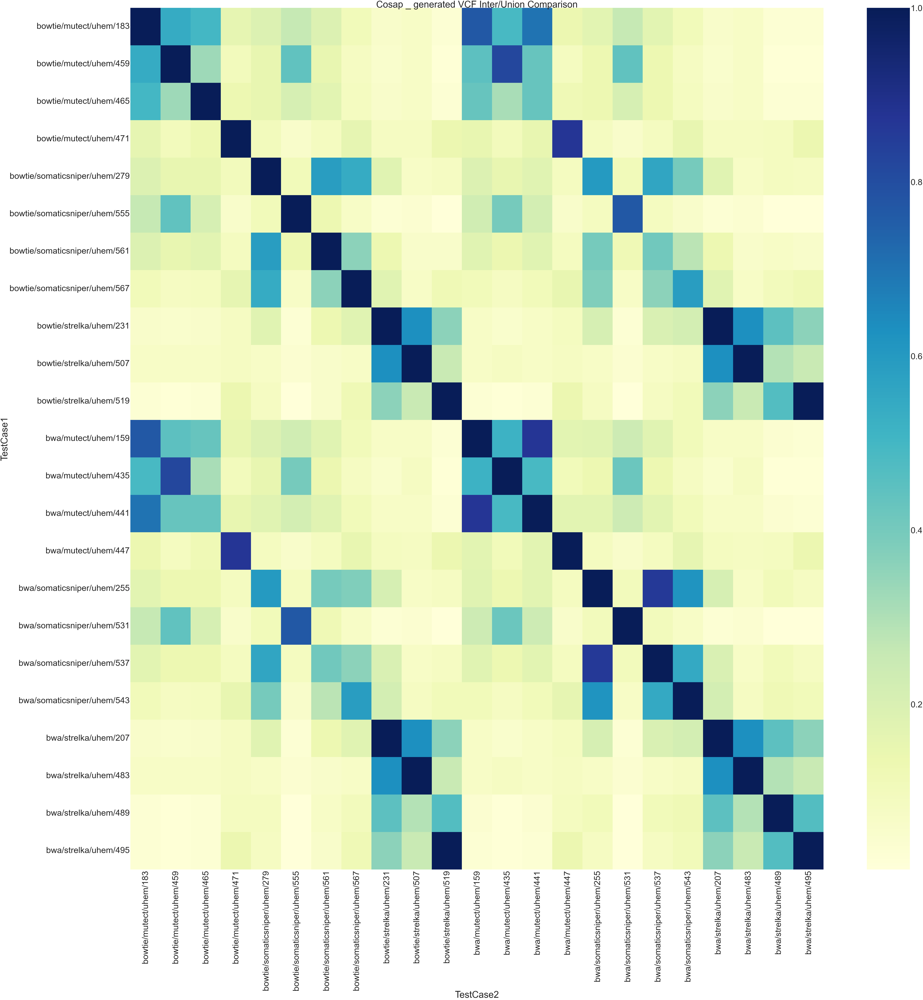

In [44]:
# uhem+Cosap RECALL HEATMAP
df_generateds_r_uhemCosap = df_generateds_r_p_uhemCosap.pivot_table(index='TestCase1', columns='TestCase2', values='Inter/Union')
plt.figure(figsize = (200,200), dpi=40)
ax = sns.heatmap(df_generateds_r_uhemCosap, annot=False, cmap="YlGnBu") #annot_kws={"size": 200}
ax.set_title('Cosap _ generated VCF Inter/Union Comparison')

fig = ax.get_figure()

## 11 - Heatmap between Generated VCFs with Recall (Equal TestCases between Environments.)

In [45]:
df_generateds_r_p_local_inter = pd.DataFrame(columns=["TestCase1", "TestCase2", "Inter/Union"]) #mutect
df_generateds_r_p_uhemCosap_inter = pd.DataFrame(columns=["TestCase1", "TestCase2", "Inter/Union"]) #strelka

for key in tqdm(inter_testcase_dict):
    for index,row in df_generateds_r_p_local.iterrows():
        if key == row['TestCase1'].split('/')[3]:
            for key2 in inter_testcase_dict:
                if key2 == row['TestCase2'].split('/')[3]:
                    df_generateds_r_p_local_inter.loc[len(df_generateds_r_p_local_inter.index)] = row
            
for key in tqdm(inter_testcase_dict):
    for index,row in df_generateds_r_p_uhemCosap.iterrows():
        if key == row['TestCase1'].split('/')[3]:
            for key2 in inter_testcase_dict:
                if key2 == row['TestCase2'].split('/')[3]:
                    df_generateds_r_p_uhemCosap_inter.loc[len(df_generateds_r_p_uhemCosap_inter.index)] = row   

100%|███████████████████████████████████████████| 46/46 [00:01<00:00, 27.35it/s]


In [47]:
# local Inter/Union HEATMAP
df_generateds_r_local_inter = df_generateds_r_p_local_inter.pivot_table(index='TestCase1', columns='TestCase2', values='Inter/Union')
plt.figure(figsize = (200,200), dpi=40)
sns.set(font_scale=15)
ax = sns.heatmap(df_generateds_r_local_inter, annot=False, cmap="YlGnBu")
ax.set_title('Local_ intersection _ generated VCF Inter/Union Comparison')

fig = ax.get_figure()

In [48]:
# uhemCosap Inter/Union HEATMAP
df_generateds_r_uhemCosap_inter = df_generateds_r_p_uhemCosap_inter.pivot_table(index='TestCase1', columns='TestCase2', values='Inter/Union')
plt.figure(figsize = (200,200), dpi=40)
ax = sns.heatmap(df_generateds_r_uhemCosap_inter, annot=False, cmap="YlGnBu") #annot_kws={"size": 200}
ax.set_title('local_ intersection _ generated VCF Inter/Union Comparison')

fig = ax.get_figure()

In [50]:
#df_generateds_r_p_local_inter
#df_generateds_r_p_uhemCosap_inter

## 12 - Scatter plot between Generated VCFs with Recall/Precision. 

In [54]:
df_generateds_r_p_VALIDATED =  pd.DataFrame(columns=["TestCase", "Inter/Union", "Precision", "Recall"])

for key in tqdm(sets_dict):
        for index, row in vcfcomparison_df_full.iterrows():
            if key == row['TestCaseNo'].split(' ')[1]:
                env_name = "local" if row['Author'] == 'GAMZE' else "uhem"
                newKey = (row['Mapper'] + '/' + row['VariantCaller']+ '/' + env_name + '/' + key).lower() 
                
        df_generateds_r_p_VALIDATED.loc[len(df_generateds_r_p_VALIDATED.index)] = [newKey, inter_union(sets_dict[key],high_confidence),get_precision(sets_dict[key],high_confidence),get_recall(sets_dict[key],high_confidence)]


100%|██████████████████████████████████████████| 71/71 [00:00<00:00, 109.80it/s]


In [56]:
df = df_generateds_r_p_VALIDATED.copy()


##Environment
df['Environment'] = df.apply(lambda _: '', axis=1)
result = []
for index, row in tqdm(df.iterrows()):
    if row["TestCase"].split('/')[2] == 'local':
        result.append("LOCAL")
    elif row["TestCase"].split('/')[2] == 'uhem' :
        result.append("Uhem+COSAP")
    else:
        result.append("CROSS")

df['Environment'] = result

##isTrimmed
result = []
for index, row in tqdm(df.iterrows()):
    for index1, row2 in vcfcomparison_df_full.iterrows():
        if row["TestCase"].split('/')[3] == row2["TestCaseNo"].split(' ')[1]:
            if  row2["isTrimmed"] == 'YES':
                result.append("YES")
            else:
                result.append("NO")

df['isTrimmed'] = result

##baseRecalibration
result = []
for index, row in tqdm(df.iterrows()):
    for index1, row2 in vcfcomparison_df_full.iterrows():
        if row["TestCase"].split('/')[3] == row2["TestCaseNo"].split(' ')[1]:
            if  row2["baseRecalibration"] == 'YES':
                result.append("YES")
            else:
                result.append("NO")

df['baseRecalibration'] = result

##Duplicates
result = []
for index, row in tqdm(df.iterrows()):
    for index1, row2 in vcfcomparison_df_full.iterrows():
        if row["TestCase"].split('/')[3] == row2["TestCaseNo"].split(' ')[1]:
            if  row2["Duplicates"] == 'MARK':
                result.append("MARK")
            else:
                result.append("DELETE")

df['Duplicates'] = result

##Mapper
result = []
for index, row in tqdm(df.iterrows()):
    for index1, row2 in vcfcomparison_df_full.iterrows():
        if row["TestCase"].split('/')[3] == row2["TestCaseNo"].split(' ')[1]:
            if  row2["Mapper"] == 'BWA':
                result.append("BWA")
            else:
                result.append("BOWTIE")

df['Mapper'] = result

##VariantCaller
result = []
for index, row in tqdm(df.iterrows()):
    for index1, row2 in vcfcomparison_df_full.iterrows():
        if row["TestCase"].split('/')[3] == row2["TestCaseNo"].split(' ')[1]:
            if  row2["VariantCaller"] == 'Mutect':
                result.append("Mutect")
            elif  row2["VariantCaller"] == 'SomaticSniper':
                result.append("SomaticSniper")
            else:
                result.append("Strelka")

df['VariantCaller'] = result

#df.drop(df.loc[df['Environment']=='CROSS'].index, inplace=True)


71it [00:00, 14857.09it/s]
71it [00:00, 306.19it/s]
71it [00:00, 358.53it/s]
71it [00:00, 347.45it/s]
71it [00:00, 351.82it/s]
71it [00:00, 358.27it/s]


In [57]:
df.index.size*[3]

[3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3]

In [58]:
fig = px.scatter(df, x="Recall", y="Precision", facet_col= 'Environment', symbol = 'VariantCaller',color="Mapper",hover_data=['Mapper'],color_discrete_sequence=["red", "blue", "green", "goldenrod", "magenta"])
fig.update_traces(marker = dict(size=12))
fig.show()

In [59]:
#isTrimmed
#fig = px.scatter(df, x="Recall", y="Precision", color="isTrimmed", facet_col= 'Environment', hover_data=['Environment'],color_discrete_sequence=["red", "green", "blue", "goldenrod", "magenta"])

#baseRecalibration
#fig = px.scatter(df, x="Recall", y="Precision", color="baseRecalibration", facet_col= 'Environment', hover_data=['Environment'],color_discrete_sequence=["red", "green", "blue", "goldenrod", "magenta"])

#Duplicates
#fig = px.scatter(df, x="Recall", y="Precision", color="Duplicates", facet_col= 'Environment', hover_data=['Environment'],color_discrete_sequence=["red", "green", "blue", "goldenrod", "magenta"])

#Mapper
#fig = px.scatter(df, x="Recall", y="Precision", color="Mapper", facet_col= 'Environment', hover_data=['Environment'],color_discrete_sequence=["red", "green", "blue", "goldenrod", "magenta"])

#VariantCaller
fig = px.scatter(df, x="Recall", y="Precision", color="VariantCaller", facet_col= 'Environment', hover_data=['Environment'],color_discrete_sequence=["red", "green", "blue", "goldenrod", "magenta"])


fig.show()



## 13 - Violin plot between Generated VCFs with Recall. (Changeable: Parameter based.)

In [60]:
# VIOLIN

fig = px.violin(df, y="Recall", x= 'Duplicates', box=True, # draw box plot inside the violin
                points='all', hover_data=df.columns ,color="Environment",violinmode='overlay' # can be 'outliers', or False
               )

fig.show()

## 14 - Venn diagrams between Generated VCFs. (Environment)

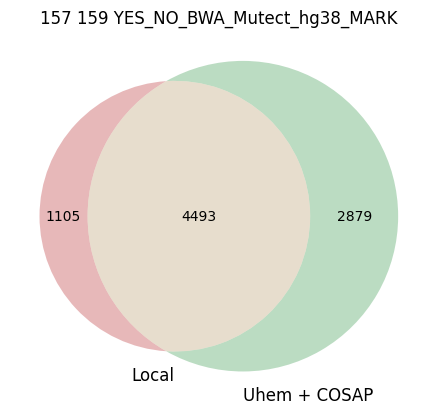

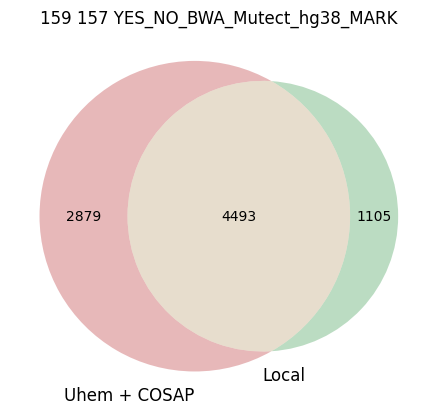

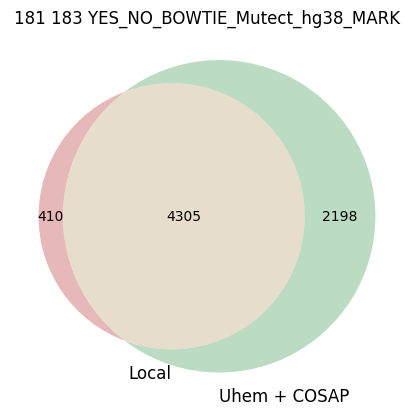

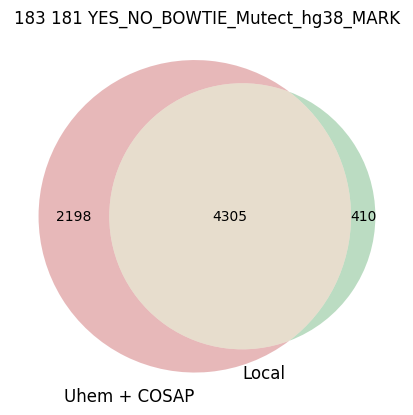

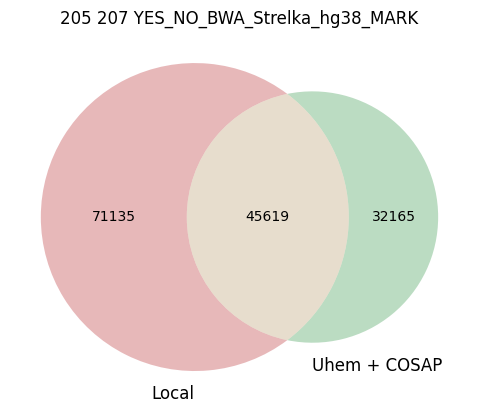

...

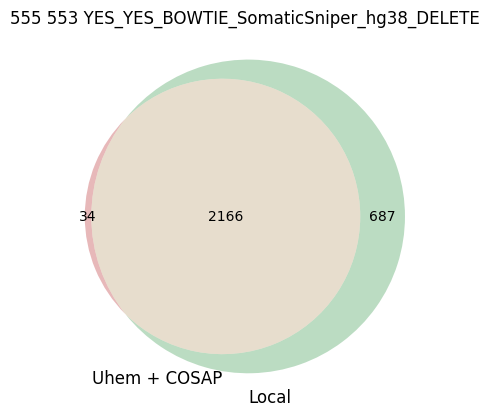

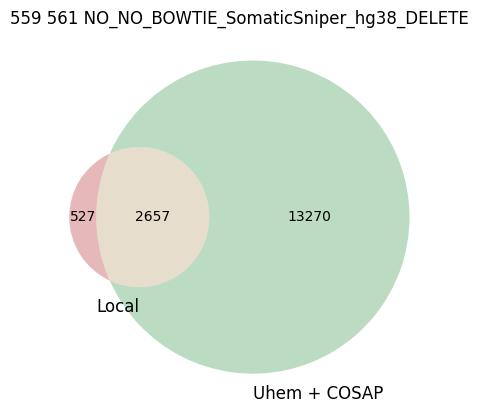

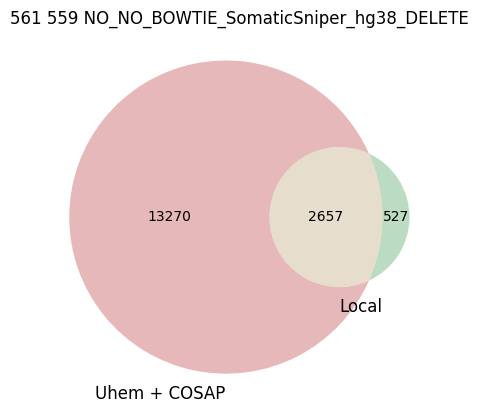

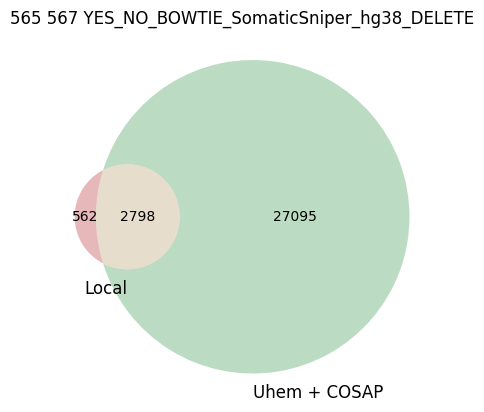

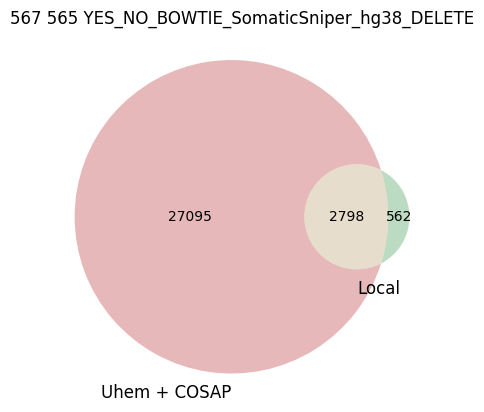

In [61]:
## SETS

count = 0;
for key in inter_testcase_dict:
    for key2 in inter_testcase_dict:
        if key != key2 and inter_testcase_dict[key] == inter_testcase_dict[key2]:
            set1 = sets_dict[key]
            set2 = sets_dict[key2]
            for index, row in vcfcomparison_df_full.iterrows():
                if row["TestCaseNo"].split(' ')[1] == key:
                    set1_env = row["Environment"]
                    
            for index, row in vcfcomparison_df_full.iterrows():
                if row["TestCaseNo"].split(' ')[1] == key2:
                    set2_env = row["Environment"]
                    break;
                    
            #if count % 2 == 0 :
            plt.rcdefaults()
            out = venn2([set1, set2], (set1_env,set2_env))
            
            plt.title(key + " " + key2 + " " + inter_testcase_dict[key])
            plt.show()
             
            #count = count + 1
            

## 15 - Venn diagrams between Generated VCFs and High Confidence. (Environment)

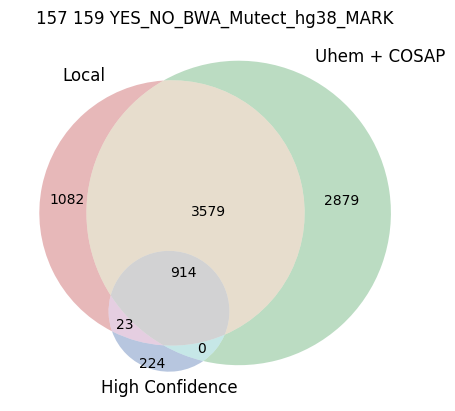

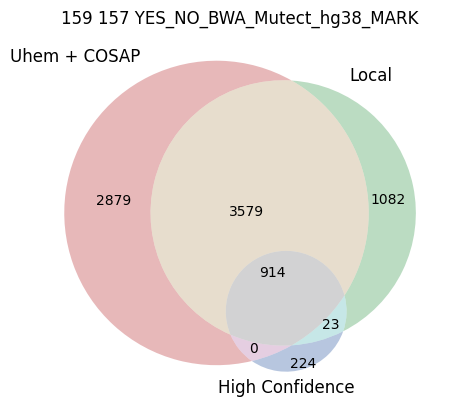

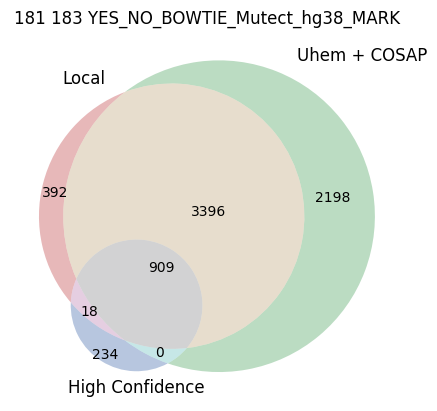

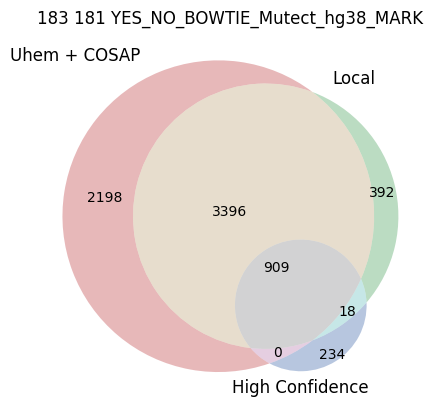

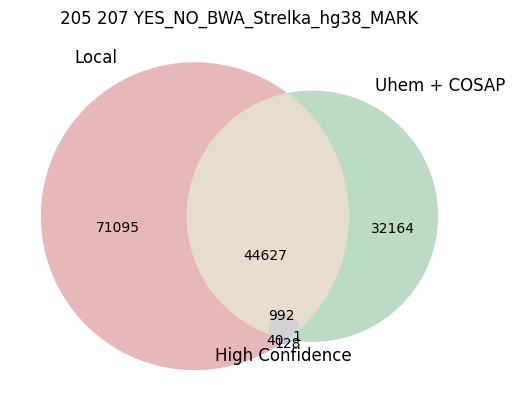

...

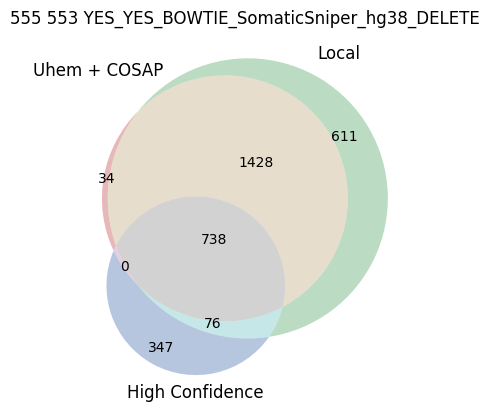

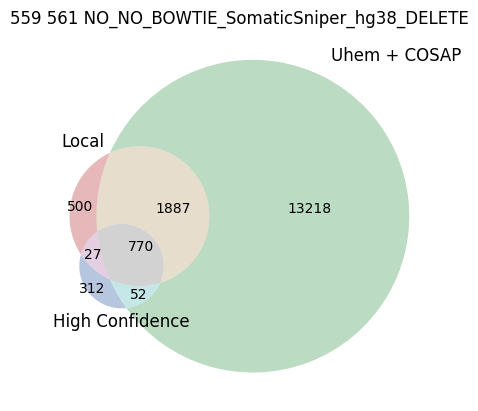

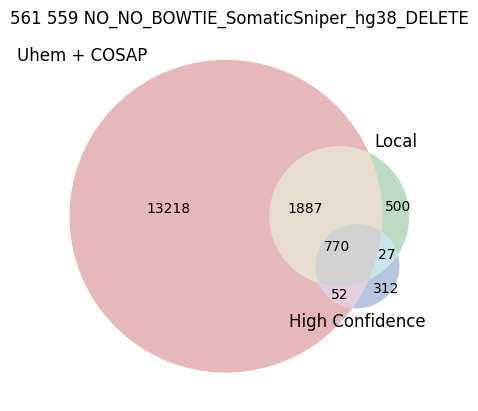

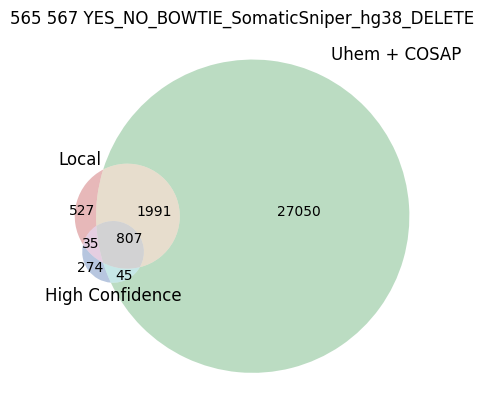

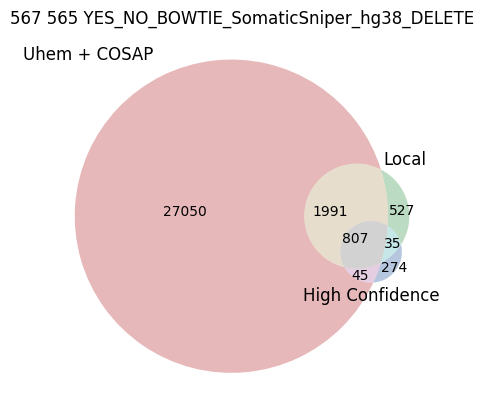

In [62]:
for key in inter_testcase_dict:
    for key2 in inter_testcase_dict:
        if key != key2 and inter_testcase_dict[key] == inter_testcase_dict[key2]:
            set1 = sets_dict[key]
            set2 = sets_dict[key2]
            set3 = ll_sets_dict[inter_testcase_dict[key].split('_')[2].lower() +
                                '/' + inter_testcase_dict[key].split('_')[3][0].lower() 
                                                   + inter_testcase_dict[key].split('_')[3][1:]]
           
            for index, row in vcfcomparison_df_full.iterrows():
                if row["TestCaseNo"].split(' ')[1] == key:
                    set1_env = row["Environment"]
                    
            for index, row in vcfcomparison_df_full.iterrows():
                if row["TestCaseNo"].split(' ')[1] == key2:
                    set2_env = row["Environment"]
                    break;
            out = venn3([set1, set2, high_confidence], (set1_env,set2_env,'High Confidence' ))
            plt.title(key + " " + key2 + " " + inter_testcase_dict[key])
            plt.show()